Goals for these graphs
- comparing the coverage of Congo to earlier publications (specifically earlier Arab Scribe, Cultural Yearbook, and Egyptian Economic and Political Review)
- comparing the coverage of Congo to the rest of the magazine in Arab Review and Arab Observer
- Ultimately argue that the increase in coverage was notable but also that Congo had a particular discourse in these publications

In [ ]:
#import libraries

In [196]:
import pandas as pd
import altair as alt
alt.renderers.enable('notebook')
alt.data_transformers.enable('default', max_rows=None)
from sklearn.feature_extraction.text import TfidfVectorizer
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import ast

In [ ]:
#import data

Datasets:
National Publications House
- Arab Observer 1960-1963
- The Scribe 1961-1964
- Arab Review 1960-1963

---
Egyptian Periodicals
- Egyptian Economic and Political Review 1954-1962

---
AAPSO Periodicals
- Afro-Asian Bulletin 1961-1967 (English edition)
- Afro-Asian Bulletin 1961-1967 (Arabic edition)

---
African American Periodicals
- Liberator 1961-1971
- Freedomways 1961-1985

In [194]:
# # 1. Arab Observer 1960-1963
# arabobserver_df = pd.read_csv('../data/arab_observer_congo_corpus.csv')

# arabobserver_df.datetime = pd.to_datetime(arabobserver_df['date'], format='%Y-%B-%d', errors='coerce')
# # ArabObserver_1960_61 = ArabObserver_df[ArabObserver_df.datetime < '1962-01-01']
# arabobserver_df['page_date'] = arabobserver_df.date.astype(str)+'_'+arabobserver_df.page_number.astype(str)
# arabobserver_df['type'] = 'arab_observer'
# # arab_review_df
# alt.themes.enable('opaque')
# arabobserver_df
# alt.Chart(arabobserver_df).mark_bar().encode(
#     x=alt.X('date_bin:O',axis=alt.Axis(title='')),
#     y=alt.Y('sum(word_counts)',axis=alt.Axis(title='')),
#     color=alt.Color('year:O', scale=alt.Scale(scheme='plasma'))
# ).properties(
#     width=300,
#     height=200,
#     title='Frequency of Congo coverage in The Arab Review 1960-1963'
# ).configure_axisX(labelAngle=0, labels=False)

In [118]:
ecopol = pd.read_csv('../data/Egyptian_Economic_and_Political_Review_1954_1962_congo_corpus.csv')
ecopol['date'] = ecopol.dates.str.split("_").str[-2:].str.join('-')
ecopol['page_date'] = ecopol.date.astype(str)+'_'+ecopol.page.astype(str)
ecopol['type'] = 'ecopol'
# arab_review_df
alt.themes.enable('opaque')
ep = alt.Chart(ecopol).mark_bar().encode(
    x=alt.X('page_date:O',axis=alt.Axis(title='')),
    y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
    color=alt.Color('date:O', scale=alt.Scale(scheme='plasma'))
).properties(
    width=300,
    height=200,
    title='Frequency of Congo coverage in The Egyptian Economic and Political Review 1954-1962'
).configure_axisX(labelAngle=0, labels=False)
ep.save('ecopol.png', scale_factor=2.0)

In [150]:
bull = pd.read_csv('../data/Afro_Asian_Bulletin_1961_1967_congo_corpus.csv')
bull['year'] = bull.dates.str.split("_").str[-1:].str[0]
bull['issue'] = bull.dates.str.split("_").str[-2:].str.join('-')
bull['page_date'] = bull.issue.astype(str)+'_'+bull.page.astype(str)
bull['type'] = 'ecopol'
years = [ '1961',  '1962','1963','1964',  '1965','1966','1967']
# arab_review_df
alt.themes.enable('opaque')
bl = alt.Chart(bull).mark_bar().encode(
    x=alt.X('year:O',axis=alt.Axis(title=''), sort =years),
    y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
    color=alt.Color('year:O', scale=alt.Scale(scheme='plasma')),
#     order='year:T'
).properties(
    width=300,
    height=200,
    title='Frequency of Congo coverage in The Afro-Asian Bulletin 1961-1967'
).configure_axisX(labelAngle=0, labels=False)
bl.save('bulletin.png', scale_factor=2.0)

In [119]:
liberator = pd.read_csv('../data/Liberator_1961_1971_congo_corpus.csv')
liberator['page_date'] = liberator.dates.astype(str)+'_'+liberator.page.astype(str)
liberator['type'] = 'liberator'
# arab_review_df
alt.themes.enable('opaque')
lib = alt.Chart(liberator).mark_bar().encode(
    x=alt.X('page_date:O',axis=alt.Axis(title='')),
    y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
    color=alt.Color('dates:O', scale=alt.Scale(scheme='plasma'))
).properties(
    width=300,
    height=200,
    title='Frequency of Congo coverage in The Liberator 1961-1970'
).configure_axisX(labelAngle=0, labels=False)
lib.save('liberator.png', scale_factor=2.0)

In [151]:
# 1. Arab Review 1960-1963
arab_review_df = pd.read_csv('../data/Arab_Review_1960_1963_congo_corpus.csv')
arab_review_df.dates.unique()
arab_review_df['page_date'] = arab_review_df.dates.astype(str)+'_'+arab_review_df.page.astype(str)
arab_review_df['type'] = 'arab_review'
# arab_review_df
alt.themes.enable('opaque')
ar = alt.Chart(arab_review_df).mark_bar().encode(
    x=alt.X('page_date:O',axis=alt.Axis(title='')),
    y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
    color=alt.Color('dates:O', scale=alt.Scale(scheme='plasma'))
).properties(
    width=300,
    height=200,
    title='Frequency of Congo coverage in The Arab Review 1960-1963'
).configure_axisX(labelAngle=0, labels=False)
ar.save('arab_review.png', scale_factor=2.0)

In [120]:
# The Scribe 1961-1964
arab_scribe_df = pd.read_csv('../data/the_scribe_1961_1965_congo_corpus.csv')
arab_scribe_df.dates.unique()
order = ['1961-1962', '1963','1963-1964', '1964']
# arab_review_1960_61 = arab_review_df.query('dates.str.contains("1960")')
arab_scribe_df['page_date'] = arab_scribe_df.dates.astype(str)+'_'+arab_scribe_df.page.astype(str)
arab_scribe_df['type'] = 'arab_scribe'
alt.themes.enable('opaque')
arabscribe = alt.Chart(arab_scribe_df).mark_bar().encode(
    x=alt.X('page_date:O',axis=alt.Axis(title='')),
    y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
    color=alt.Color('dates:O', scale=alt.Scale(scheme='plasma'))
).properties(
    width=300,
    height=200,
    title='Frequency of Congo coverage in The Arab Scribe 1961-1964'
).configure_axisX(labelAngle=0, labels=False)
arabscribe.save('arab_scribe.png', scale_factor=2.0)

In [195]:
# # The Scribe 1961-1964
# arab_scribe_df = pd.read_csv('../data/the_scribe_1961_1965_congo_corpus.csv')
# arab_scribe_df.dates.unique()
# order = ['1961-1962', '1963','1963-1964', '1964']
# # arab_review_1960_61 = arab_review_df.query('dates.str.contains("1960")')
# arab_scribe_df['page_date'] = arab_scribe_df.dates.astype(str)+'_'+arab_scribe_df.page.astype(str)
# arab_scribe_df['type'] = 'arab_scribe'
# alt.themes.enable('opaque')
# alt.Chart(arab_scribe_df).mark_bar().encode(
#     x=alt.X('page_date:O',axis=alt.Axis(title='')),
#     y=alt.Y('sum(spacy_word_counts)',axis=alt.Axis(title='')),
#     color=alt.Color('dates:O', scale=alt.Scale(scheme='plasma'))
# ).properties(
#     width=300,
#     height=200,
#     title='Frequency of Congo coverage in The Arab Scribe 1961-1964'
# ).configure_axisX(labelAngle=0, labels=False)

In [11]:
freedomways_df = pd.read_csv('../data/Freedomways_Scraped_1961_1985_congo_corpus.csv')

In [54]:
freedomways_df['date'] = freedomways_df.year.astype(str)+'-'+freedomways_df.month.astype(str)+'-'+freedomways_df.day.astype(str)
freedomways_df['datetime'] = pd.to_datetime(freedomways_df['date'], format='%Y-%B-%d', errors='coerce')
freedomways_df = freedomways_df.loc[freedomways_df.date < '1970-01-01']

In [121]:
freedomways_df['page_date'] = freedomways_df.date.astype(str)+'_'+freedomways_df.page_number.astype(str)
alt.themes.enable('opaque')
fr = alt.Chart(freedomways_df).mark_bar().encode(
    x='page_date:O',
    y='sum(spacy_word_counts)',
    color=alt.Color('year:O', scale=alt.Scale(scheme='plasma'))
).properties(
    height=200,
    width=300,
    title='Frequency of Congo coverage in Freedomways 1961-1969'
).configure_axisX(labelAngle=0, labels=False)
fr.save('freedomways.png')

In [ ]:
#distribution of Congo in multiple publications until September 1960

In [ ]:
#TFIDF + NMF of how Congo was being covered across publications

In [ ]:
# early congo and late congo models of the arab observer trained on other publications
# look at classification, create a weighted average based on page/word distribution
# look at absolute change

In [268]:
scribe_classified = pd.read_csv('../data/Arab_Review_1960_1963_ao__classified_corpus.csv')

In [ ]:

    
Freedomways_Scraped_1961_1985_ao__classified_corpus.csv
Liberator_1961_1971_ao__classified_corpus.csv
Egyptian_Economic_and_Political_Review_1954_1962_ao__classified_corpus.csv
Arab_Review_1960_1963_ao__classified_corpus.csv
Afro_Asian_Bulletin_1961_1967_ao__classified_corpus.csv

In [269]:
scribe_classified.prediction[scribe_classified.prediction == 0] = 'early_congo'
scribe_classified.prediction[scribe_classified.prediction == 1] = 'late_congo'

In [270]:
scribe_classified['page_date'] = scribe_classified.dates.astype(str)+'_'+scribe_classified.page.astype(str)
scribe_classified['abs_change_0'] = 0.5 - scribe_classified.prediction_proba_0
scribe_classified['abs_change_0'] = scribe_classified.abs_change_0.abs()

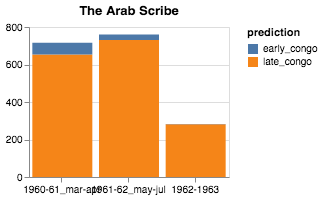

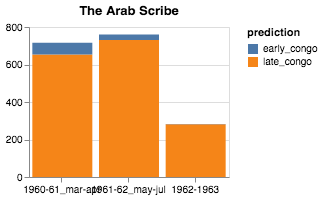

In [271]:
alt.themes.enable('opaque')
alt.Chart(scribe_classified).mark_bar().encode(
    x=alt.X('dates:N',axis=alt.Axis(title='')),
    y=alt.Y('count():Q',axis=alt.Axis(title='')),
    color='prediction:N',
).properties(
    height=150,
    width=200,
    title='The Arab Scribe'
).configure_axisX(labelAngle=0)
# scribe_class.save('arab_scribe_class_ao.png', scale_factor=2.0)

Text(0.5, 0, 'absolute change from decision boundary')

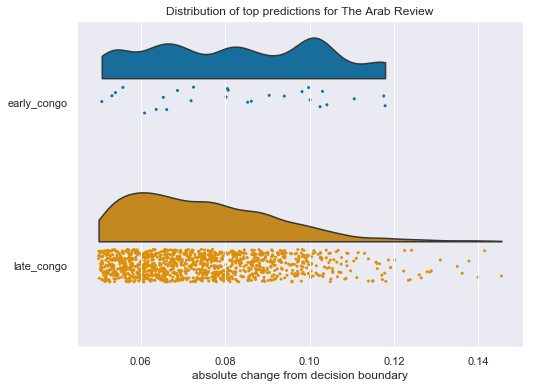

In [275]:
import ptitprince as pt
dy="prediction"; dx="abs_change_0"; pal = sns.color_palette('colorblind'); df= scribe_classified.loc[scribe_classified.abs_change_0 > 0.05]
import matplotlib.collections as clt
sns.set(style="darkgrid")
# sns.set(rc={'figure.figsize':(8.7,8.27)}, style="whitegrid")
f, ax = plt.subplots(figsize=(8, 6))
ax = pt.half_violinplot( x = dx, y = dy, data = df, palette = pal, bw = .2, cut = 0.,scale = "area", width = .6, inner = None, order=[ "early_congo", "late_congo"])
ax=sns.stripplot( x = dx, y = dy, data = df, palette = pal, edgecolor = "white",size = 3, jitter = 1, zorder = 0, order=[ "early_congo", "late_congo"])
# ax = sns.violinplot(x="prediction", y="abs_change_0", inner=None, color=".8", data=congo_classified.loc[congo_classified.abs_change_0 > 0.1])

# #  ax = sns.violinplot(x="day", y="total_bill", data=tips,
# # ...                     inner=None, color=".8")
# ax = sns.stripplot(x="prediction", y="abs_change_0", data=congo_classified.loc[congo_classified.abs_change_0 > 0.1], jitter=True)

# ax.set_size_inches(15,15)
# axes = g.axes.flatten()
ax.set_title('Distribution of top predictions for The Arab Review')
ax.set_ylabel('')
ax.set_xlabel('absolute change from decision boundary')
# ax.figure.savefig('the_review_raincloud_plot.png')

In [199]:
freedomways_classified = pd.read_csv('../data/Freedomways_Scraped_1961_1985_ao__classified_corpus.csv')
freedomways_classified.prediction[freedomways_classified.prediction == 0] = 'early_congo'
freedomways_classified.prediction[freedomways_classified.prediction == 1] = 'late_congo'

In [201]:
freedomways_classified['date'] = freedomways_classified.year.astype(str)+'-'+freedomways_classified.month.astype(str)+'-'+freedomways_classified.day.astype(str)
scribe_classified['page_date'] = freedomways_classified.date.astype(str)+'_'+freedomways_classified.page_number.astype(str)
freedomways_classified['abs_change_0'] = 0.5 - freedomways_classified.prediction_proba_0
freedomways_classified['abs_change_0'] = freedomways_classified.abs_change_0.abs()

In [204]:
freedomways_classified = freedomways_classified.loc[freedomways_classified.date < '1970-01-01']

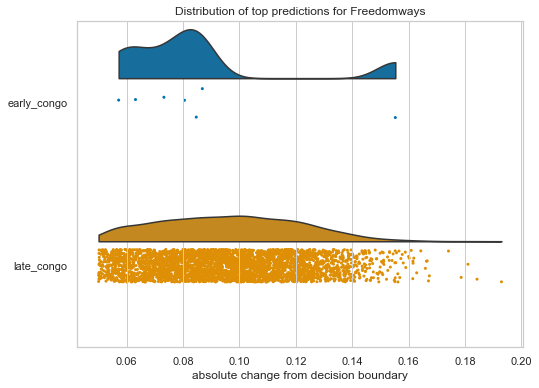

In [252]:

dy="prediction"; dx="abs_change_0"; pal = sns.color_palette('colorblind'); df= freedomways_classified.loc[freedomways_classified.abs_change_0 > 0.05]
import matplotlib.collections as clt
sns.set(style="whitegrid")
# sns.set(rc={'figure.figsize':(8.7,8.27)}, style="whitegrid")
f, ax = plt.subplots(figsize=(8, 6))
ax = pt.half_violinplot( x = dx, y = dy, data = df, palette = pal, bw = .2, cut = 0.,scale = "area", width = .6, inner = None, order=[ "early_congo", "late_congo"])
ax=sns.stripplot( x = dx, y = dy, data = df, palette = pal, edgecolor = "white",size = 3, jitter = 1, zorder = 0, order=[ "early_congo", "late_congo"])
# ax = sns.violinplot(x="prediction", y="abs_change_0", inner=None, color=".8", data=congo_classified.loc[congo_classified.abs_change_0 > 0.1])

# #  ax = sns.violinplot(x="day", y="total_bill", data=tips,
# # ...                     inner=None, color=".8")
# ax = sns.stripplot(x="prediction", y="abs_change_0", data=congo_classified.loc[congo_classified.abs_change_0 > 0.1], jitter=True)

# ax.set_size_inches(15,15)
# axes = g.axes.flatten()
ax.set_title('Distribution of top predictions for Freedomways')
ax.set_ylabel('')
ax.set_xlabel('absolute change from decision boundary')
ax.figure.savefig('freedomways_raincloud_plot.png')

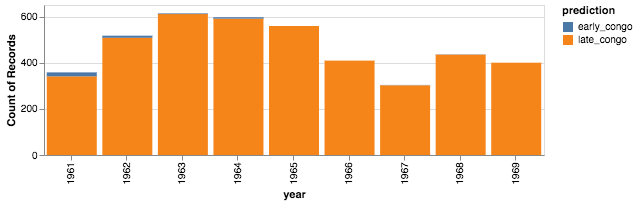

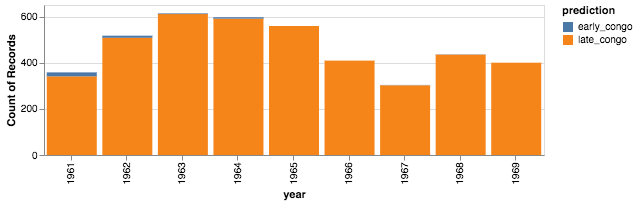

In [206]:
alt.Chart(freedomways_classified).mark_bar().encode(
    x='year:N',
    y='count():Q',
    color='prediction:N',
).properties(
    height=150,
    width=500
).configure_axisX()